<a href="https://colab.research.google.com/github/ChronoBoot/sante-publique-france-off-enhancer/blob/test/open_food_fact_filtering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TODO
- Add a method to take the median of a nutrional fact based on pnns_groups_2
Using this in complement with equation solver can help fill a lot of missing data
- Add a category to store the different range of each nutrional fact based on the tables from the nutri score algorithm => simplification of the algorithm => calculating multiples values with multiple unknows
- Look at dataclass => eliminer les inits et les getters setters + class immutable
- Look at abstract class and pydantics, typing and mypypyd

# Data preparation for Open Food Facts

## File loading and main class

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import traceback

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [ ]:
# TODO Optimize the data loading

def load_csv():
  off_path = '/content/drive/MyDrive/Alternance/Projets/Projet 1/data/fr.openfoodfacts.org.products.csv'
  off_df = pd.read_csv(off_path, delimiter = '\t')
  return off_df

In [ ]:
off_df = load_csv()
print(f"Number of products {len(off_df)}")

<ipython-input-5-15121a8c41e5>:5: DtypeWarning: Columns (0,3,5,19,20,24,25,26,27,28,35,36,37,38,39,48) have mixed types. Specify dtype option on import or set low_memory=False.
  off_df = pd.read_csv(off_path, delimiter = '\t')


Number of products 320772


In [ ]:
off_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 320772 entries, 0 to 320771
Columns: 162 entries, code to water-hardness_100g
dtypes: float64(106), object(56)
memory usage: 396.5+ MB


In [ ]:
class DataFrameField:
    def __init__(self, name, dtype=None, na_percent=None, field_type=None):
        """
        Initialize a DataFrameField object with only the name required at creation.
        Other attributes can be set later.

        Parameters:
        - name (str): The name of the DataFrame column.
        - dtype (str, optional): The data type of the column. Defaults to None.
        - na_percent (float, optional): The percentage of missing (NA) values in the column. Defaults to None.
        - field_type (str, optional): Specifies whether the field is 'categorical' or 'numerical'. Defaults to None.
        """
        self.name = name
        self.dtype = dtype
        self.na_percent = na_percent
        # The percentage of non-mising values in the column
        self.fill_percent = 100 - na_percent if na_percent is not None else None
        self.field_type = field_type

    @staticmethod
    def process_na_percent(col, set_na_percent=False):
      na_percent = col.isna().mean() * 100
      return na_percent

    def __repr__(self):
        """
        Provide a string representation of the DataFrameField instance.
        """
        return (f"DataFrameField(name='{self.name}', dtype='{self.dtype}', "
                f"na_percent='{self.na_percent}', fill_percent='{self.fill_percent}',"
                f"field_type='{self.field_type}')")

    def display_info(self):
        """
        Print out the details of the DataFrameField instance.
        """
        print(f"Column Name: {self.name}")
        if self.dtype:
            print(f"Data Type: {self.dtype}")
        if self.na_percent is not None:
            print(f"Percentage of Missing Values: {self.na_percent}%")
        if self.fill_percent is not None :
            print(f"Percent of Non-Missing Values: {self.fill_percent}")
        if self.field_type:
            print(f"Field Type: {self.field_type}")

    # Additional methods to set attributes after object creation
    def set_dtype(self, dtype):
        self.dtype = dtype

    def set_na_percent(self, na_percent):
        self.na_percent = na_percent
        self.fill_percent = 100 - na_percent

    def set_field_type(self, field_type):
        self.field_type = field_type

    def process_and_set_na_percent(self, col):
        na_percent = DataFrameField.process_na_percent(col)
        self.set_na_percent(na_percent)



## Step 1 : Cleaning and filtering of features and products

### Feature listing

Split the columns attributes in 2, categorical and numerical

In [ ]:
def feature_listing(off_df):
  categorical_columns = []
  numerical_columns = []

  for name, dtype in off_df.dtypes.items():
    na_percent = DataFrameField.process_na_percent(off_df[name])

    if(dtype == 'int64' or dtype == 'float64'):
      df_col = DataFrameField(name, dtype, na_percent, field_type='numerical')
      numerical_columns.append(df_col)
    else:
      df_col = DataFrameField(name, dtype, na_percent, field_type='categorical')
      categorical_columns.append(df_col)

  df_fields = categorical_columns + numerical_columns

  return categorical_columns, numerical_columns, df_fields

In [ ]:
def dataframe_fields_to_dataframe(df_fields):
  rows_data = []
  for field in df_fields :
    row_data = {
        'name' : field.name,
        'dtype' : field.dtype,
        'na_percent' : field.na_percent,
        'fill_percent' : field.fill_percent,
        'field_type' : field.field_type
    }
    rows_data.append(row_data)

  return pd.DataFrame(rows_data)


In [ ]:
categorical_columns, numerical_columns, df_fields = feature_listing(off_df)

dataframe_fields_to_dataframe(categorical_columns)

,name,dtype,na_percent,fill_percent,field_type
0,code,object,0.007170,99.992830,categorical
1,url,object,0.007170,99.992830,categorical
2,creator,object,0.000623,99.999377,categorical
3,created_t,object,0.000935,99.999065,categorical
4,created_datetime,object,0.002806,99.997194,categorical
5,last_modified_t,object,0.000000,100.000000,categorical
6,last_modified_datetime,object,0.000000,100.000000,categorical
7,product_name,object,5.537266,94.462734,categorical
8,generic_name,object,83.541269,16.458731,categorical
9,quantity,object,67.322896,32.677104,categorical


In [ ]:
dataframe_fields_to_dataframe(numerical_columns)

,name,dtype,na_percent,fill_percent,field_type
0,no_nutriments,float64,100.000000,0.000000,numerical
1,additives_n,float64,22.393787,77.606213,numerical
2,ingredients_from_palm_oil_n,float64,22.393787,77.606213,numerical
3,ingredients_from_palm_oil,float64,100.000000,0.000000,numerical
4,ingredients_that_may_be_from_palm_oil_n,float64,22.393787,77.606213,numerical
5,ingredients_that_may_be_from_palm_oil,float64,100.000000,0.000000,numerical
6,nutrition_grade_uk,float64,100.000000,0.000000,numerical
7,energy_100g,float64,18.598568,81.401432,numerical
8,energy-from-fat_100g,float64,99.732832,0.267168,numerical
9,fat_100g,float64,23.967491,76.032509,numerical


### Find a target

We find which columns have more than 50% of values missing and we return the one with the most amount of non-missing values.
We will prefer to have the target to be as close a 50% missing value as possible because with too little values, prediction is going to be harder and less reliable

In [ ]:
def find_target(columns):
  candidates = []
  for col in columns :
    if col.na_percent > 50 :
      candidates.append(col)

  return candidates

def get_recommanded_target(columns, nb_choice = 1):
  candidates = find_target(columns)
  targets = []

  for i in range (0, nb_choice):
    target = min(candidates, key = lambda candidate : candidate.na_percent)
    targets.append(target)
    candidates.remove(target)

  return targets


In [ ]:
candidates = find_target(categorical_columns)

nb_candidates = len(candidates)

print(f"Number of candidates : {nb_candidates}")

targets = get_recommanded_target(categorical_columns, 10)

for target in targets :
  print(target)

Number of candidates : 36
DataFrameField(name='additives_tags', dtype='object', na_percent='51.77883356402678', fill_percent='48.22116643597322',field_type='categorical')
DataFrameField(name='additives_fr', dtype='object', na_percent='51.77883356402678', fill_percent='48.22116643597322',field_type='categorical')
DataFrameField(name='quantity', dtype='object', na_percent='67.32289601336775', fill_percent='32.67710398663225',field_type='categorical')
DataFrameField(name='pnns_groups_2', dtype='object', na_percent='70.54262840896337', fill_percent='29.457371591036633',field_type='categorical')
DataFrameField(name='pnns_groups_1', dtype='object', na_percent='71.47101367949821', fill_percent='28.528986320501787',field_type='categorical')
DataFrameField(name='categories_fr', dtype='object', na_percent='73.68504732333247', fill_percent='26.31495267666753',field_type='categorical')
DataFrameField(name='categories', dtype='object', na_percent='73.68535907124063', fill_percent='26.31464092875937

In [ ]:
targets_names = ["pnns_groups_1", "pnns_groups_2"]

The chosen target is pnns_groups_1 and pnns_groups_2 which most like stands for PNNS (Programme National Nutrition Santé) which categorize foods.

pnns_groups_1 is the main category while pnns_groups_2 is the subcategory.

Example :
pnns_groups_1 : Fruits and Vegetables
pnns_groups_2 : Vegetables

### Remove rows without the target value

In [ ]:
def filtered_row(df, targets_names, incorrect_value = None):
  filtered_off_df = df.dropna(subset=targets_names)

  if(incorrect_value != None):
    for target_name in targets_names :
      filtered_off_df = filtered_off_df.loc[df[target_name] != incorrect_value]

  return filtered_off_df

In [ ]:
filtered_off_df = filtered_row(off_df, targets_names, "unknown")

In [ ]:
filtered_off_df

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,packaging,packaging_tags,brands,brands_tags,categories,categories_tags,categories_fr,origins,origins_tags,manufacturing_places,manufacturing_places_tags,labels,labels_tags,labels_fr,emb_codes,emb_codes_tags,first_packaging_code_geo,cities,cities_tags,purchase_places,stores,countries,countries_tags,countries_fr,ingredients_text,allergens,allergens_fr,traces,traces_tags,traces_fr,serving_size,no_nutriments,additives_n,additives,additives_tags,additives_fr,ingredients_from_palm_oil_n,ingredients_from_palm_oil,ingredients_from_palm_oil_tags,ingredients_that_may_be_from_palm_oil_n,ingredients_that_may_be_from_palm_oil,ingredients_that_may_be_from_palm_oil_tags,nutrition_grade_uk,nutrition_grade_fr,pnns_groups_1,pnns_groups_2,states,states_tags,states_fr,main_category,main_category_fr,image_url,image_small_url,energy_100g,energy-from-fat_100g,fat_100g,saturated-fat_100g,butyric-acid_100g,caproic-acid_100g,caprylic-acid_100g,capric-acid_100g,lauric-acid_100g,myristic-acid_100g,palmitic-acid_100g,stearic-acid_100g,arachidic-acid_100g,behenic-acid_100g,lignoceric-acid_100g,cerotic-acid_100g,montanic-acid_100g,melissic-acid_100g,monounsaturated-fat_100g,polyunsaturated-fat_100g,omega-3-fat_100g,alpha-linolenic-acid_100g,eicosapentaenoic-acid_100g,docosahexaenoic-acid_100g,omega-6-fat_100g,linoleic-acid_100g,arachidonic-acid_100g,gamma-linolenic-acid_100g,dihomo-gamma-linolenic-acid_100g,omega-9-fat_100g,oleic-acid_100g,elaidic-acid_100g,gondoic-acid_100g,mead-acid_100g,erucic-acid_100g,nervonic-acid_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,sucrose_100g,glucose_100g,fructose_100g,lactose_100g,maltose_100g,maltodextrins_100g,starch_100g,polyols_100g,fiber_100g,proteins_100g,casein_100g,serum-proteins_100g,nucleotides_100g,salt_100g,sodium_100g,alcohol_100g,vitamin-a_100g,beta-carotene_100g,vitamin-d_100g,vitamin-e_100g,vitamin-k_100g,vitamin-c_100g,vitamin-b1_100g,vitamin-b2_100g,vitamin-pp_100g,vitamin-b6_100g,vitamin-b9_100g,folates_100g,vitamin-b12_100g,biotin_100g,pantothenic-acid_100g,silica_100g,bicarbonate_100g,potassium_100g,chloride_100g,calcium_100g,phosphorus_100g,iron_100g,magnesium_100g,zinc_100g,copper_100g,manganese_100g,fluoride_100g,selenium_100g,chromium_100g,molybdenum_100g,iodine_100g,caffeine_100g,taurine_100g,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
174,290616,http://world-fr.openfoodfacts.org/produit/0000...,b7,1484605978,2017-01-16T22:32:58Z,1484606542,2017-01-16T22:42:22Z,Salade Cesar,Laitue en salade,0.980 kg,Frais,frais,Kirkland Signature,kirkland-signature,Légumes-feuilles,"en:plant-based-foods-and-beverages,en:plant-ba...","Aliments et boissons à base de végétaux,Alimen...",Québec,quebec,Brossard Québec,brossard-quebec,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Costco,Canada,en:canada,Canada,INGREDIENTS : LAITUE. VINAIGRETTE (HUILE DE CA...,NaN,NaN,CONTIENT : OEUF. LAIT. ANCHOIS. SOYA. BLE. SEI...,fr:contient-oeuf-lait-anchois-soya-ble-seigle-...,Contient-oeuf-lait-anchois-soya-ble-seigle-org...,100 g,NaN,0.0,[ ingredients -> fr:ingredients ] [ laitue-...,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,c,Fruits and vegetables,Vegetables,"en:to-be-checked, en:complete, en:nutrition-fa...","en:to-be-checked,en:complete,en:nutrition-fact...","A vérifier,Complet,Informations nutritionnelle...",en:fresh-vegetables,Légumes frais,NaN,NaN,1210.0,NaN,12.0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.05600,23.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.00,22.00,NaN,NaN,NaN,2.1600,0.850,NaN,0.000000,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0000,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

### Display the fill rates of the features of the dataset

In [ ]:
def display_rate(df_fields):
  for field in df_fields :
    field.process_and_set_na_percent(filtered_off_df[field.name])
    print(f"Fill rate {field.name} : {field.fill_percent}")

In [ ]:
display_rate(df_fields)

Fill rate code : 100.0
Fill rate url : 100.0
Fill rate creator : 100.0
Fill rate created_t : 100.0
Fill rate created_datetime : 99.99854838943808
Fill rate last_modified_t : 100.0
Fill rate last_modified_datetime : 100.0
Fill rate product_name : 99.20887224375444
Fill rate generic_name : 62.96360812321271
Fill rate quantity : 94.33581558739421
Fill rate packaging : 89.42211383530027
Fill rate packaging_tags : 89.42356544586218
Fill rate brands : 98.58613131269144
Fill rate brands_tags : 98.58322809156759
Fill rate categories : 100.0
Fill rate categories_tags : 100.0
Fill rate categories_fr : 100.0
Fill rate origins : 25.32044303154349
Fill rate origins_tags : 25.29866887311472
Fill rate manufacturing_places : 43.55412329980113
Fill rate manufacturing_places_tags : 43.54541363642962
Fill rate labels : 51.323143027188664
Fill rate labels_tags : 51.42185254539912
Fill rate labels_fr : 51.42185254539912
Fill rate emb_codes : 36.60381192933559
Fill rate emb_codes_tags : 36.60236031877368
Fi

### Feature selection

We select features with more than 50% of non-missing values which could be use for predicting our target

In [ ]:
def features_selection(df_fields):
  features = []

  for field in df_fields:
    if(field.fill_percent > 50):
      features.append(field)

  return features

In [ ]:
features = features_selection(df_fields)

df_features = dataframe_fields_to_dataframe(features)

In [ ]:
df_features

,name,dtype,na_percent,fill_percent,field_type
0,code,object,0.000000,100.000000,categorical
1,url,object,0.000000,100.000000,categorical
2,creator,object,0.000000,100.000000,categorical
3,created_t,object,0.000000,100.000000,categorical
4,created_datetime,object,0.001452,99.998548,categorical
5,last_modified_t,object,0.000000,100.000000,categorical
6,last_modified_datetime,object,0.000000,100.000000,categorical
7,product_name,object,0.791128,99.208872,categorical
8,generic_name,object,37.036392,62.963608,categorical
9,quantity,object,5.664184,94.335816,categorical


The features that have been selected are as follow :

- additives_n
- ingredients_from_palm_oil_n
- ingredients_that_may_be_from_palm_oil_n
- energy_100g
- fat_100g
- saturated-fat_100g
- carbohydrates_100g
- sugars_100g
- fiber_100g
- proteins_100g
- salt_100g
- sodium_100g
- nutrition-score-fr_100g
- nutrition_grade_fr

There is one expection to the list :
- fruits-vegetables-nuts_100g
This is one is chosen not due to his filling rate but rather because it is the only missing value to calculate the nutrition score which will be helpful later on

There is a focus on the ingredients or nutrition facts

In [ ]:
def filter_fields(df, fields):
  return df[fields]

In [ ]:
features_names = [
    "additives_n",
    "ingredients_from_palm_oil_n",
    "ingredients_that_may_be_from_palm_oil_n",
    "energy_100g",
    "fat_100g",
    "saturated-fat_100g",
    "carbohydrates_100g",
    "sugars_100g",
    "fiber_100g",
    "proteins_100g",
    "salt_100g",
    "sodium_100g",
    "nutrition-score-fr_100g",
    "nutrition_grade_fr",
    "fruits-vegetables-nuts_100g"
  ]

targets_names = [
  "pnns_groups_1",
  "pnns_groups_2",
]

identifier_name = "product_name"

fields_names = features_names + targets_names + [identifier_name]

filtered_off_df = filter_fields(filtered_off_df, fields_names)

In [ ]:
filtered_off_df

,additives_n,ingredients_from_palm_oil_n,ingredients_that_may_be_from_palm_oil_n,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutrition-score-fr_100g,nutrition_grade_fr,fruits-vegetables-nuts_100g,pnns_groups_1,pnns_groups_2,product_name
174,0.0,0.0,0.0,1210.0,12.0,7.0,23.0,0.0,2.00,22.00,2.1600,0.850,6.0,c,NaN,Fruits and vegetables,Vegetables,Salade Cesar
175,10.0,0.0,1.0,1520.0,14.4,NaN,54.1,28.1,2.05,4.79,0.9220,0.363,NaN,NaN,NaN,Sugary snacks,Biscuits and cakes,Danoises à la cannelle roulées
177,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cereals and potatoes,Bread,Flute
180,5.0,0.0,0.0,1090.0,10.7,2.0,38.7,24.7,2.00,3.33,0.6470,0.255,9.0,c,NaN,Sugary snacks,Biscuits and cakes,Chaussons tressés aux pommes
182,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cereals and potatoes,Legumes,lentilles vertes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320759,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fruits and vegetables,Fruits,Лимон — лайм
320763,0.0,0.0,0.0,21.0,0.2,0.2,0.5,0.5,0.20,0.50,0.0254,0.010,2.0,c,NaN,Beverages,Non-sugared beverages,Thé vert Earl grey
320765,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fish Meat Eggs,Processed meat,Rillette d'oie
320766,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Salty snacks,Nuts,NaN


### Delete duplicates

We use jellyfish to measure string distances. This is a more accurate way to find duplicates but it consumes more ressources

In [ ]:
!pip install jellyfish

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 4.8 MB/s eta 0:00:00


In [ ]:
from jellyfish import jaro_winkler_similarity

We consider that 2 products with the same name are a duplicate

In [ ]:
def format_identifier(df, identifier_name):
  df[identifier_name] = df[identifier_name].str.lower().str.strip().str.replace(" ", "")
  return df

def drop_duplicates(df, identifier_name):
  return df.drop_duplicates(subset=identifier_name)

def delete_duplicates(df, identifier_name, string_distance = False):
  result = drop_duplicates(format_identifier(df, identifier_name), identifier_name)

  if(string_distance):
    result = drop_duplicates_string_distance(result, identifier_name)

  return result

def is_duplicate(string, df, identifier_name, threshold = 0.9):
    for i, row in df:
        if jaro_winkler_similarity(string, row[identifier_name]) > threshold:
            return True
    return False

# This methods remove rows with a similar identifier_name
# The complexity is of O(n2) so if performance is a concern should not be used
def drop_duplicates_string_distance(df, identifier_name, threshold = 0.9):
     # This list will store the first occurrence of unique values
    representatives = []
    # This list will keep track of indices to keep
    indices_to_keep = []

    for i, row_value in df[identifier_name].items():
        # Compute if current row_value is similar to any of the representatives
        if any(jaro_winkler_similarity(str(row_value), rep) > threshold for rep in representatives):
            continue  # Skip adding this index if similar to an existing representative
        else:
            representatives.append(str(row_value))  # Add to representatives
            indices_to_keep.append(i)  # Mark index to keep

    # Return a DataFrame containing only the rows with indices we decided to keep
    return df.loc[indices_to_keep]

In [ ]:
identifier_name = 'product_name'

filtered_off_no_duplicates = delete_duplicates(filtered_off_df, identifier_name)

<ipython-input-29-6d089aeafe1e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[identifier_name] = df[identifier_name].str.lower().str.strip().str.replace(" ", "")


In [ ]:
filtered_off_no_duplicates

,additives_n,ingredients_from_palm_oil_n,ingredients_that_may_be_from_palm_oil_n,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutrition-score-fr_100g,nutrition_grade_fr,fruits-vegetables-nuts_100g,pnns_groups_1,pnns_groups_2,product_name
174,0.0,0.0,0.0,1210.0,12.0,7.0,23.0,0.0,2.00,22.00,2.160,0.850000,6.0,c,NaN,Fruits and vegetables,Vegetables,saladecesar
175,10.0,0.0,1.0,1520.0,14.4,NaN,54.1,28.1,2.05,4.79,0.922,0.363000,NaN,NaN,NaN,Sugary snacks,Biscuits and cakes,danoisesàlacannelleroulées
177,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cereals and potatoes,Bread,flute
180,5.0,0.0,0.0,1090.0,10.7,2.0,38.7,24.7,2.00,3.33,0.647,0.255000,9.0,c,NaN,Sugary snacks,Biscuits and cakes,chaussonstressésauxpommes
182,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cereals and potatoes,Legumes,lentillesvertes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320751,NaN,NaN,NaN,1643.0,2.8,0.6,74.8,2.6,5.90,13.00,0.680,0.267717,-4.0,a,NaN,Cereals and potatoes,Bread,tartinescraquantesbioausarrasin
320758,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Sugary snacks,Sweets,mieldecamargue
320759,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fruits and vegetables,Fruits,лимон—лайм
320765,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fish Meat Eggs,Processed meat,rilletted'oie


### Main function to clean and filter features and products

In [ ]:
def cleaning_and_filtering_of_features_and_products(df):
  categorical_columns, numerical_columns, df_fields = feature_listing(df)

  candidates = find_target(categorical_columns)

  targets_names = ["pnns_groups_1", "pnns_groups_2"]

  filtered_off_df = filtered_row(df, targets_names, "unknown")
  print(f"Number of lines with {targets_names} : {len(filtered_off_df)}")

  features_names = [
    "additives_n",
    "ingredients_from_palm_oil_n",
    "ingredients_that_may_be_from_palm_oil_n",
    "energy_100g",
    "fat_100g",
    "saturated-fat_100g",
    "carbohydrates_100g",
    "sugars_100g",
    "fiber_100g",
    "proteins_100g",
    "salt_100g",
    "sodium_100g",
    "nutrition-score-fr_100g",
    "nutrition_grade_fr",
    "fruits-vegetables-nuts_100g"
  ]

  filtered_df_fields = [field for field in df_fields if field.name in features_names]

  identifier_name = 'product_name'

  fields = features_names + targets_names + [identifier_name]
  filtered_off_df = filter_fields(filtered_off_df, fields)

  filtered_off_no_duplicates = delete_duplicates(filtered_off_df, identifier_name)
  print(f"Number of lines with {targets_names} and without duplicates: {len(filtered_off_no_duplicates)}")

  return filtered_off_no_duplicates, filtered_df_fields


In [ ]:
filtered_off_no_duplicates, filtered_df_fields = cleaning_and_filtering_of_features_and_products(off_df)

Number of lines with ['pnns_groups_1', 'pnns_groups_2'] : 68889
Number of lines with ['pnns_groups_1', 'pnns_groups_2'] and without duplicates: 51087


In [ ]:
filtered_off_no_duplicates

,additives_n,ingredients_from_palm_oil_n,ingredients_that_may_be_from_palm_oil_n,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutrition-score-fr_100g,nutrition_grade_fr,fruits-vegetables-nuts_100g,pnns_groups_1,pnns_groups_2,product_name
174,0.0,0.0,0.0,1210.0,12.0,7.0,23.0,0.0,2.00,22.00,2.160,0.850000,6.0,c,NaN,Fruits and vegetables,Vegetables,saladecesar
175,10.0,0.0,1.0,1520.0,14.4,NaN,54.1,28.1,2.05,4.79,0.922,0.363000,NaN,NaN,NaN,Sugary snacks,Biscuits and cakes,danoisesàlacannelleroulées
177,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cereals and potatoes,Bread,flute
180,5.0,0.0,0.0,1090.0,10.7,2.0,38.7,24.7,2.00,3.33,0.647,0.255000,9.0,c,NaN,Sugary snacks,Biscuits and cakes,chaussonstressésauxpommes
182,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cereals and potatoes,Legumes,lentillesvertes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320751,NaN,NaN,NaN,1643.0,2.8,0.6,74.8,2.6,5.90,13.00,0.680,0.267717,-4.0,a,NaN,Cereals and potatoes,Bread,tartinescraquantesbioausarrasin
320758,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Sugary snacks,Sweets,mieldecamargue
320759,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fruits and vegetables,Fruits,лимон—лайм
320765,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fish Meat Eggs,Processed meat,rilletted'oie


## Step 2 : Identify and process abnormal values

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

### Data visualization

Graph about the selected features to detect abnormal values

In [ ]:
def boxplot_features_pyplot(df, features_names, title):
  df_ingredients_features = df[features_names]
  df_ingredients_features_melted = pd.melt(df_ingredients_features, var_name = "Feature", value_name = "Value")

  sns.boxplot(x = "Feature", y = "Value", data = df_ingredients_features_melted)
  plt.xticks(rotation = 45)
  plt.title(title)
  plt.ylabel("Value")
  plt.show()

def boxplot_features_plotly(df, features_names, title):
    df_filtered = df[features_names]

    fig = px.box(df_filtered, y=features_names, labels={'variable': 'Features', 'value': 'Value'}, title=title)

    fig.show()

def bar_chart_pyplot(df, feature_name, title):
  df_ingredients_features = df[features_names]

  category_counts = df[feature_name].value_counts()

  plt.figure(figsize=(15,5))

  plt.bar(category_counts.index, category_counts.values)

  plt.title(title)
  plt.xlabel('Category')
  plt.ylabel('Frequency')

  plt.xticks(rotation=45)
  plt.show()

def bar_chart_plotly(df, feature_name, title):
    fig = px.bar(df, x=feature_name, title=title,
                 labels={feature_name: 'Category', 'count': 'Frequency'},
                 text_auto=True)

    fig.update_layout(
        xaxis_title='Category',
        yaxis_title='Frequency',
        xaxis={'categoryorder':'total descending'}
    )

    fig.update_xaxes(tickangle=45)

    fig.show()

In [ ]:
def display_features_boxplots(df):
  nb_additives_feature_name = ["additives_n"]

  nb_ingredients_features_names = [
      "ingredients_from_palm_oil_n",
      "ingredients_that_may_be_from_palm_oil_n",
  ]

  energy_feature_name = ["energy_100g"]

  nutrional_features_names = [
      "fat_100g",
      "saturated-fat_100g",
      "carbohydrates_100g",
      "sugars_100g",
      "fiber_100g",
      "proteins_100g",
      "salt_100g",
      "sodium_100g",
      "fruits-vegetables-nuts_100g"
  ]

  nutriscore_feature_name = ["nutrition-score-fr_100g"]

  boxplot_features_plotly(df, nb_additives_feature_name, "Boxplots for number of additives")
  boxplot_features_plotly(df, nb_ingredients_features_names, "Boxplots for number of ingredients")
  boxplot_features_plotly(df, energy_feature_name, "Boxplots for energy feature")
  boxplot_features_plotly(df, nutrional_features_names, "Boxplots for nutrional features")
  boxplot_features_plotly(df, nutriscore_feature_name, "Boxplot for nutriscore feature")

def display_features_bar_plots(df):
  nutriscore_grade_feature_name = "nutrition_grade_fr"

  pnns_groups_1_feature_name = "pnns_groups_1"
  pnns_groups_2_feature_name = "pnns_groups_2"

  bar_chart_pyplot(df, nutriscore_grade_feature_name, "Boxplot for nutriscore grade feature")
  bar_chart_pyplot(df, pnns_groups_1_feature_name, "Boxplot for pnns main groups feature")
  bar_chart_pyplot(df, pnns_groups_2_feature_name, "Boxplot for pnns main subgroups feature")

In [ ]:
df, features = cleaning_and_filtering_of_features_and_products(off_df)

Number of lines with ['pnns_groups_1', 'pnns_groups_2'] : 68889
Number of lines with ['pnns_groups_1', 'pnns_groups_2'] and without duplicates: 51087


In [ ]:
display_features_boxplots(df)

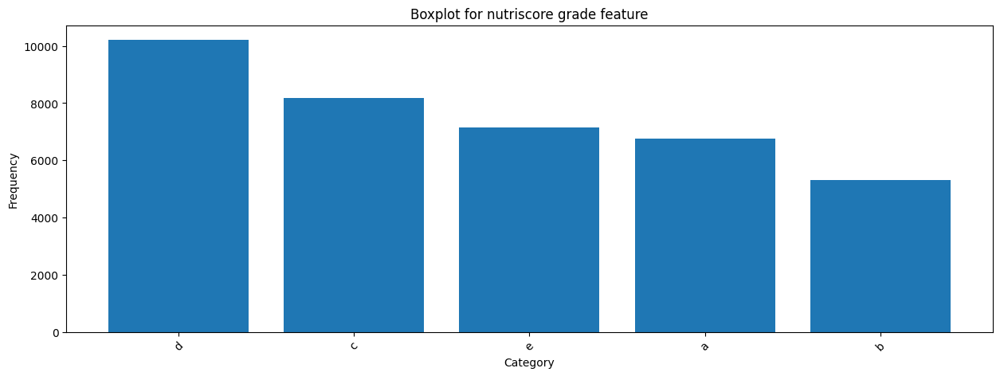

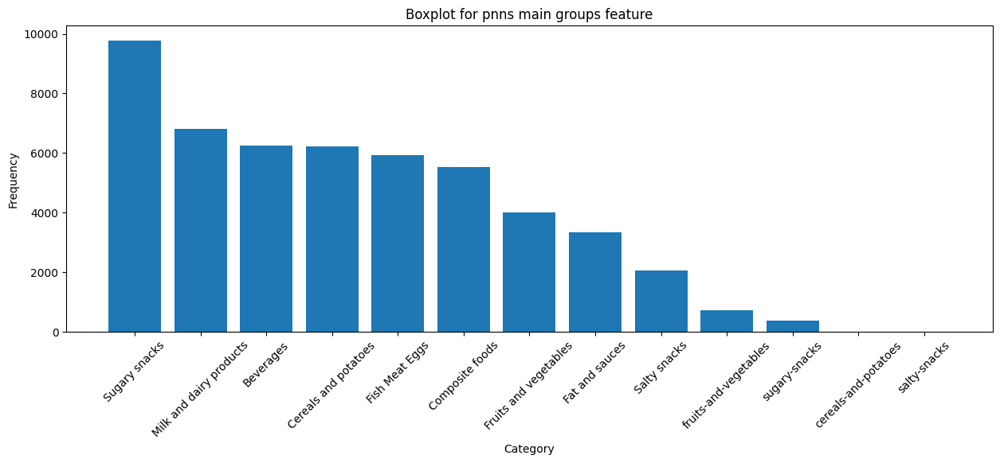

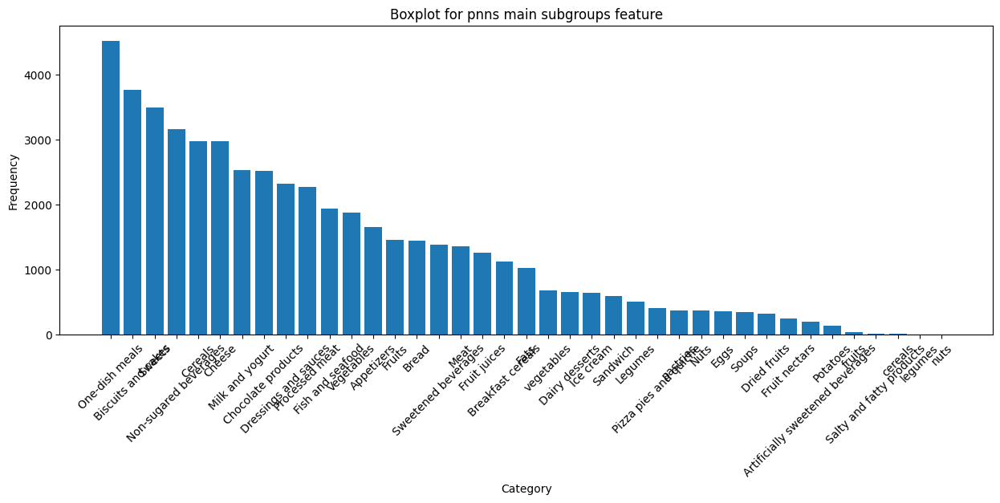

In [ ]:
display_features_bar_plots(df)

### Expected range value from features

---

*   additives_n
*   ingredients_from_palm_oil_n
*   ingredients_that_may_be_from_palm_oil_n


There is no specification on the number of additives in a products on regulations (that I could found) but rather on the allowed type of additives.

So the range will be decided using statistical methods on the values

However, we do have the average number of additives, around 4.5 :
https://www.eatrightpro.org/about-us/for-media/press-releases/60-percent-of-foods-purchased-by-americans-contain-technical-food-additives



---


We do have the same problems with nutrional facts. There is no global "allowed" or "usual" range, it varies from product to product.
Of course a minimum and maximum do exist but doesn't seem to be used or register.
To solve this problem, we are going to use multiple limits.

First, we are measuring the quantity of nutriments in 100g (except for energy_100g and nutrition-score-fr_100g) so the amount is between 0 and 100g.

Second, we can be more precise than that by having the top limit being the highest known value in any kind of food.

For energy_100g, the value can only be positive and a maximum value of 3700kJ (the max value being 37 kJ/g https://www.fao.org/3/Y5022E/y5022e04.htm)

For the nutrional score, this will be decided using statistical methods on the value. We do know that the score can be negative and from the graphic visualization, there seems to be no value below -20, so this will be the lower bound.
Some infos about nutrional score :
https://www.santepubliquefrance.fr/content/download/150257/file/Nutriscore_reglement_usage_20231222.pdf


For the nutrional the only values allowed are [a, b, c, d, e] and it seems that there is no value outside of these. An extra filter will be put on to ensure this.

---



To sum up, this are the range of allowed values for known field :
*   fat_100g : 0-100
There could be some products which are 100% made of fat like cooking oils, this should not be removed
*   saturated-fat_100g : 0-100
Products with 100% fat could have a way higher saturated portion than expected based on others values
*   sugars_100g : 0-100
Sugar itself
*   salt_100g : 0-100
Salt itself
*   energy_100g : 0-3700
*   carbohydrates_100g : 0-47
https://www.myfooddata.com/articles/foods-highest-in-carbohydrates.php
*   fiber_100g : 0-11
https://www.myfooddata.com/articles/foods-high-in-dietary-fiber.php
*   proteins_100g : 0-33
https://www.myfooddata.com/articles/foods-highest-in-protein.php
*   sodium_100g : 0-40 : https://www.cdc.gov/salt/index.htm#:~:text=Salt%20is%20sodium%20chloride%20which,about%202%2C400%20mg%20of%20sodium.
* fruits-vegetables-nuts_100g : 0-100
A fruit

The range left to calculate are for the following fields :
*   additives_n
*   ingredients_from_palm_oil_n
*   ingredients_that_may_be_from_palm_oil_n
*   nutrition-score-fr_100g

### Abnormal values identification

In [ ]:
# A function to calculate the IQR outlier thresholds
def outlier_thresholds(data, column_name, default_lower_bound = 0):
    Q1 = data[column_name].quantile(0.25)
    Q3 = data[column_name].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = max(Q1 - 1.5 * IQR, default_lower_bound)
    upper_bound = Q3 + 1.5 * IQR
    return lower_bound, upper_bound


In [ ]:
features_missing_ranges = [
    ["additives_n", 0],
    ["ingredients_from_palm_oil_n", 0],
    ["ingredients_that_may_be_from_palm_oil_n", 0],
    ["nutrition-score-fr_100g", -20]
]

for feature in features_missing_ranges :
    lower_bound, upper_bound = outlier_thresholds(df, feature[0], feature[1])
    print(f"Feature : {feature[0]} : range : {lower_bound}, {upper_bound}")

Feature : additives_n : range : 0, 7.5
Feature : ingredients_from_palm_oil_n : range : 0.0, 0.0
Feature : ingredients_that_may_be_from_palm_oil_n : range : 0.0, 0.0
Feature : nutrition-score-fr_100g : range : -20.0, 36.0


From the above result, we can conclude that there are very little products with ingredients form palm oil.
From the graphical visualization, we also see that there is no ingredients with more than 6 ingredients from palm oil, so no filtering seems necessary.



### Abnormal values processing

In this section, we will decide which abnormal values will be deleted or replaced

For the nutrional facts, every single value which is not in the defined range will be removed because it is simply not possible.
As a reminder, all values must be positives and below or equal 100 (for 100g nutrional element). The second filter is about the highest possible known value in any food for the given nutrional fact.

For the others facts :
- additives_n : We are going to remove values which are too high and too rare. Even though this is possible (and do exists) we can not verify by hand and are assuming that this is a data entry mistake
- ingredients_from_palm_oil_n : Same reasoning as before even though values are not as extremes
- ingredients_that_may_be_from_palm_oil_n : Same reasoning as before

For thoses, we are looking at the highest value where above or equal values have a frequency of 1% of less.
If the highest possible value has a frequency of 2% for example, no value will be removed at all.


For the nutrition score, we are going to use the IQR which fits pretty well the data.

For the nutrition grade, which is a category, we are just going to ensure that the data is conform to the allowed value.


In [ ]:
class Bounds:
  def __init__(self, column, min, max):
    self.column = column
    self.min = min
    self.max = max

In [ ]:
def filter_abnormal_values(bounds_list, data):
  for bounds in bounds_list :
    data[bounds.column] = data[(data[bounds.column] >= bounds.min) & (data[bounds.column] <= bounds.max)][bounds.column]
  return data

def filter_allowed_values(allowed_values, data, column):
  data[column] = data[data[column].isin(allowed_values)][column]
  return data

def find_higher_bound(data, column, frequency_threshold):
  frequencies = data[column].value_counts(normalize=True).sort_index(ascending=False)

  cumulative_frequencies = frequencies.cumsum()
  filtered_values = cumulative_frequencies[cumulative_frequencies <= frequency_threshold]

  if not filtered_values.empty:
    return filtered_values.index[-1]
  else:
    return max(data[column])

In [ ]:
def abnormal_values_processing(off_df):
  df, features = cleaning_and_filtering_of_features_and_products(off_df)

  frequency_threshold = 0.01

  additives_n_higher_bound = find_higher_bound(df, "additives_n", frequency_threshold)
  ingredients_from_palm_oil_n_higher_bound = find_higher_bound(df, "ingredients_from_palm_oil_n", frequency_threshold)
  ingredients_that_may_be_from_palm_oil_n_higher_bound = find_higher_bound(df, "ingredients_that_may_be_from_palm_oil_n", frequency_threshold)

  nutrition_score_lower_bound, nutrition_score_higher_bound = outlier_thresholds(df, "nutrition-score-fr_100g", -20)

  bounds_list = [
      Bounds("additives_n", 0, additives_n_higher_bound),
      Bounds("ingredients_from_palm_oil_n", 0, ingredients_from_palm_oil_n_higher_bound),
      Bounds("ingredients_that_may_be_from_palm_oil_n", 0, ingredients_that_may_be_from_palm_oil_n_higher_bound),
      Bounds("fat_100g", 0, 100),
      Bounds("saturated-fat_100g", 0, 100),
      Bounds("sugars_100g", 0, 100),
      Bounds("salt_100g", 0, 100),
      Bounds("energy_100g", 0, 3700),
      Bounds("carbohydrates_100g", 0, 47),
      Bounds("fiber_100g", 0, 11),
      Bounds("proteins_100g", 0, 33),
      Bounds("sodium_100g", 0, 40),
      Bounds("nutrition-score-fr_100g", nutrition_score_lower_bound, nutrition_score_higher_bound),
      Bounds("fruits-vegetables-nuts_100g", 0, 100)
  ]

  allowed_values_nutrional_grade = ['a', 'b', 'c', 'd', 'e']

  filter_df = filter_abnormal_values(bounds_list, df)
  filter_df = filter_allowed_values(allowed_values_nutrional_grade, filter_df, "nutrition_grade_fr")

  return filter_df

In [ ]:
filter_df = abnormal_values_processing(off_df)

Number of lines with ['pnns_groups_1', 'pnns_groups_2'] : 68889
Number of lines with ['pnns_groups_1', 'pnns_groups_2'] and without duplicates: 51087


In [ ]:
filter_df

,additives_n,ingredients_from_palm_oil_n,ingredients_that_may_be_from_palm_oil_n,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutrition-score-fr_100g,nutrition_grade_fr,fruits-vegetables-nuts_100g,pnns_groups_1,pnns_groups_2,product_name
174,0.0,0.0,0.0,1210.0,12.0,7.0,23.0,0.0,2.00,22.00,2.160,0.850000,6.0,c,NaN,Fruits and vegetables,Vegetables,saladecesar
175,10.0,0.0,1.0,1520.0,14.4,NaN,NaN,28.1,2.05,4.79,0.922,0.363000,NaN,NaN,NaN,Sugary snacks,Biscuits and cakes,danoisesàlacannelleroulées
177,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cereals and potatoes,Bread,flute
180,5.0,0.0,0.0,1090.0,10.7,2.0,38.7,24.7,2.00,3.33,0.647,0.255000,9.0,c,NaN,Sugary snacks,Biscuits and cakes,chaussonstressésauxpommes
182,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cereals and potatoes,Legumes,lentillesvertes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320751,NaN,NaN,NaN,1643.0,2.8,0.6,NaN,2.6,5.90,13.00,0.680,0.267717,-4.0,a,NaN,Cereals and potatoes,Bread,tartinescraquantesbioausarrasin
320758,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Sugary snacks,Sweets,mieldecamargue
320759,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fruits and vegetables,Fruits,лимон—лайм
320765,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fish Meat Eggs,Processed meat,rilletted'oie


In [ ]:
display_features_boxplots(filter_df)

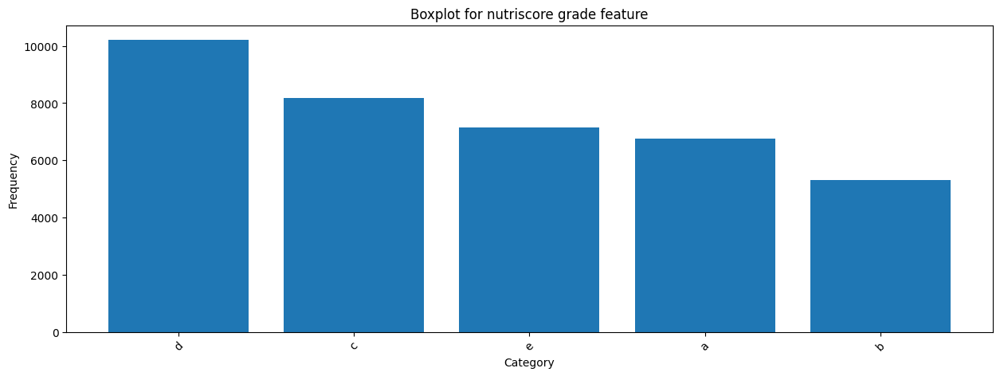

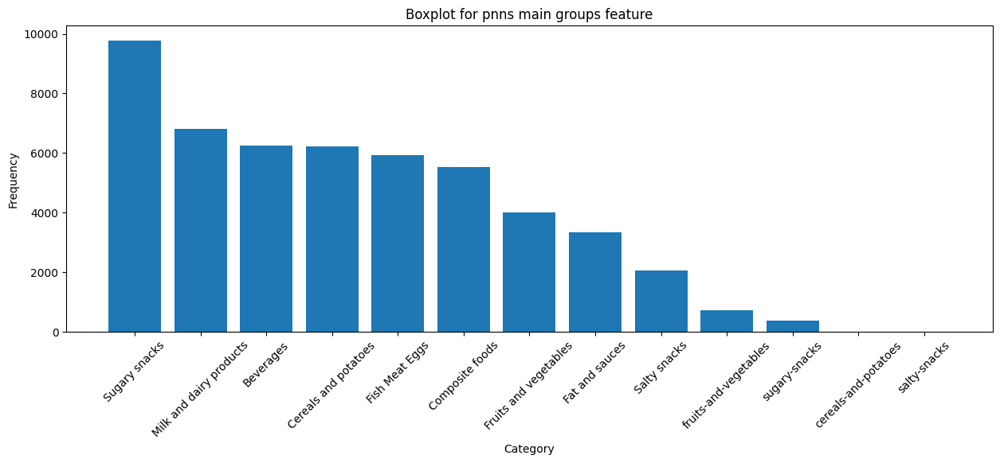

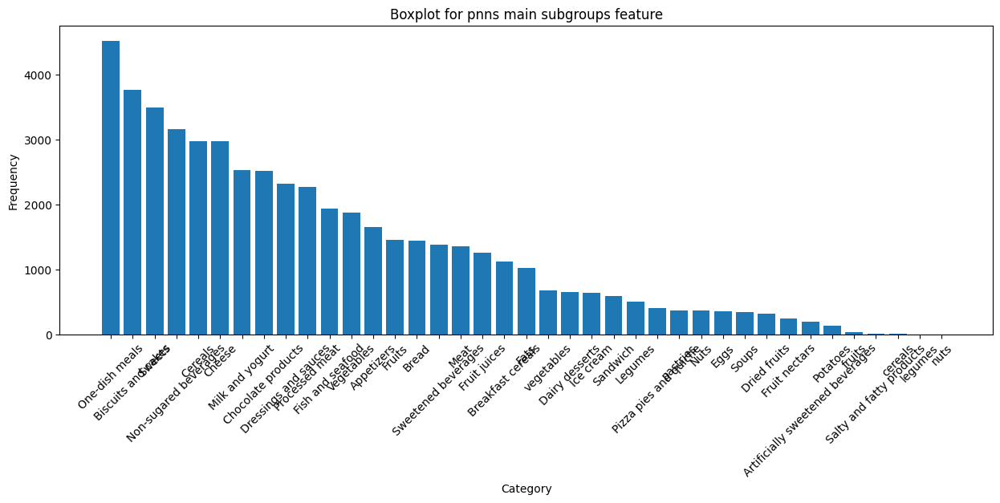

In [ ]:
display_features_bar_plots(filter_df)

## Step 3 : Identify and process missing values

In [ ]:
import missingno as msno

### Missing values identification

In [ ]:
class NaCount :
  def __init__(self, column, sumNa = None):
    self.column = column
    if(sumNa != None):
      self.sumNa = sumNa

  def calculate_sum_na(self, df):
    self.sumNa = df[self.column].isna().sum()


In [ ]:
def get_na_counts (df):
  fields = filter_df.columns

  na_counts = [NaCount(col) for col in fields]

  for na_count in na_counts :
    na_count.calculate_sum_na(filter_df)

  return na_counts

In [ ]:
def na_counts_to_dataframe(na_counts):
  data = [{"name" : na_count.column, 'sumNa' : na_count.sumNa} for na_count in na_counts]
  df = pd.DataFrame(data)
  df.set_index('name', inplace=True)

  return df

In [ ]:
filter_df = abnormal_values_processing(off_df)

na_counts = get_na_counts(filter_df)
df_na_counts = na_counts_to_dataframe(na_counts)

Number of lines with ['pnns_groups_1', 'pnns_groups_2'] : 68889
Number of lines with ['pnns_groups_1', 'pnns_groups_2'] and without duplicates: 51087


In [ ]:
df_na_counts.sort_values(by = 'sumNa', ascending = False)

,sumNa
name,
fruits-vegetables-nuts_100g,49387
fiber_100g,27060
carbohydrates_100g,24076
nutrition-score-fr_100g,13467
nutrition_grade_fr,13465
saturated-fat_100g,12639
sugars_100g,12496
sodium_100g,12381
salt_100g,12376


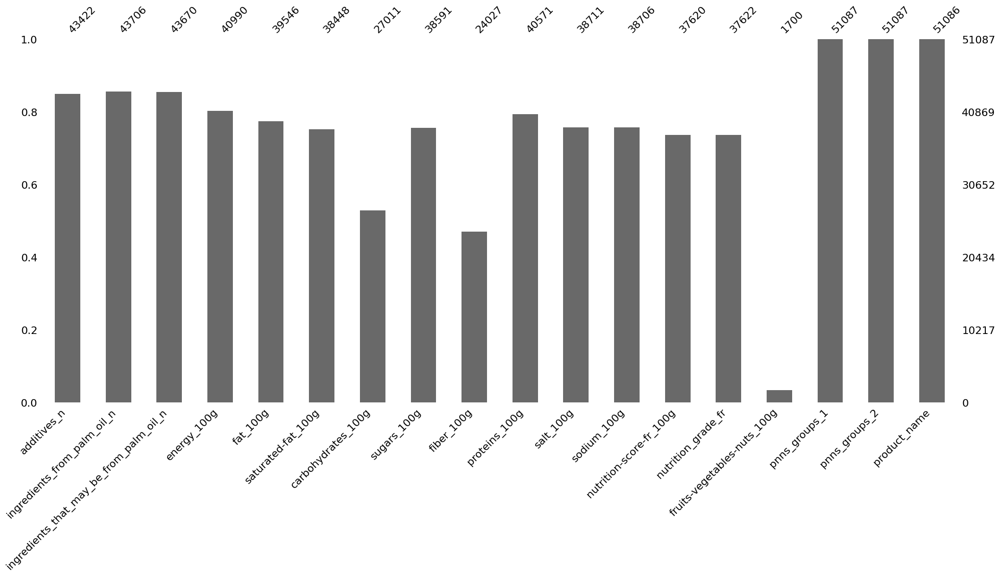

In [ ]:
# Bar chart of non-missing values
msno.bar(filter_df)
plt.show()

### Missing values nature

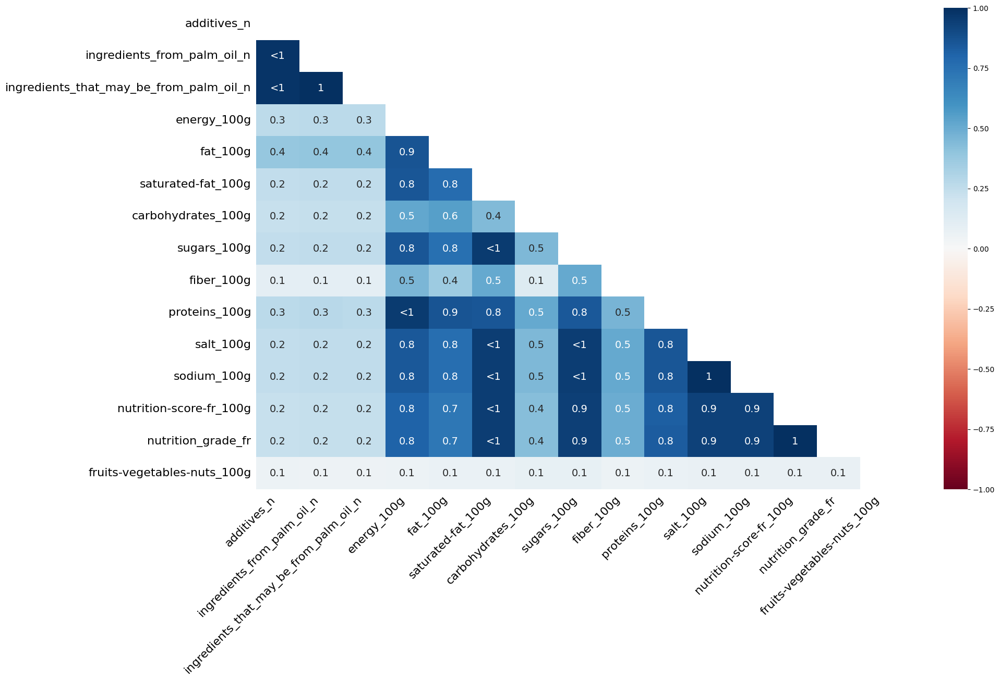

In [ ]:
# Heatmap to show correlations of missingness between columns
heatmap_df = filter_df.drop(["product_name", "pnns_groups_1", "pnns_groups_2"], axis=1)
msno.heatmap(heatmap_df)
plt.show()

### Choice of the method of imputation

The most basic imputation that can be done is with the nutrition grade.
This data being based on the nutrition score and the pnns group, a simple mapping is enough.
The algorithm have been updated in 2023 and should concern every product put in the market since 2024.
https://www.agrolab.com/en/news/food-news/4655-nutriscore-update-radar-09-2023-en.html

Because the analysed data doesn't go after 2017, the old algorithm will be used.

According to the nutrition score reglement, only water should be of nutrition grade A but this doesn't seem to be the case in the data and also in what can be found in the market so beverages will not be handle due to the lack of clear mapping between the score and the grade.

In [ ]:
from scipy.optimize import fsolve

In [ ]:
def nutrition_score_to_nutrition_grade_impl(nutrition_score, is_beverage):
    if is_beverage:
        # Explain why I did not implement that
        raise NotImplementedError("Beverage convertion is not handled")
    else:
        if nutrition_score <= -1:
            return 'a'
        elif 0 <= nutrition_score <= 2:
            return 'b'
        elif 3 <= nutrition_score <= 10:
            return 'c'
        elif 11 <= nutrition_score <= 18:
            return 'd'
        else:  # 19 and above
            return 'e'

def nutrition_score_to_nutrition_grade(nutrition_score, pnns_main_group):
  return nutrition_score_to_nutrition_grade_impl(nutrition_score, pnns_main_group.lower() == 'beverages')

def is_beverage(row):
  return row['pnns_groups_1'].lower() == 'beverages'

def grade_letter_to_number(letter):
    if letter == 'a':
        return 0
    elif letter == 'b':
        return 1
    elif letter == 'c':
        return 2
    elif letter == 'd':
        return 3
    elif letter == 'e':
        return 4
    else:
        raise ValueError(f"Unknown grade value: {letter}")

To guess some missing nutrional facts, we are going to implement the algorithm to calculte the nutrition score : https://www.santepubliquefrance.fr/content/download/150257/file/Nutriscore_reglement_usage_20231222.pdf

In [ ]:
class NutritionFacts:
    def __init__(self, energy=None, sat_fat=None, sugars=None, sodium=None, protein=None, fiber=None, fruits_vegetables_nuts=None):
        self._energy = energy
        self._sat_fat = sat_fat
        self._sugars = sugars
        self._sodium = sodium
        self._protein = protein
        self._fiber = fiber
        self._fruits_vegetables_nuts = fruits_vegetables_nuts
        self.energy_points = self.energy_to_energy_points()
        self.sat_fat_points = self.sat_fat_to_points()
        self.sugars_points = self.sugars_to_points()
        self.sodium_points= self.sodium_to_points()
        self.protein_points = self.protein_to_points()
        self.fiber_points = self.fiber_to_points()
        self.fruits_vegetables_nuts_points = self.fruits_vegetables_nuts_to_points()
        self._update_attributes()

    def _update_attributes(self):
        self._attributes = {
            'energy': self._energy,
            'sat_fat': self._sat_fat,
            'sugars': self._sugars,
            'sodium': self._sodium,
            'protein': self._protein,
            'fiber': self._fiber,
            'fruits_vegetables_nuts': self._fruits_vegetables_nuts
        }

    @property
    def energy(self):
        return self._energy

    @energy.setter
    def energy(self, value):
        self._energy = value
        self._energy_points = self.energy_to_energy_points() if self._energy else None
        self._update_attributes()

    @property
    def sat_fat(self):
        return self._sat_fat

    @sat_fat.setter
    def sat_fat(self, value):
        self._sat_fat = value
        self.sat_fat_points = self.sat_fat_to_points() if self._sat_fat else None
        self._update_attributes()

    @property
    def sugars(self):
        return self._sugars

    @sugars.setter
    def sugars(self, value):
        self._sugars = value
        self.sugars_points = self.sugars_to_points() if self._sugars else None
        self._update_attributes()

    @property
    def sodium(self):
        return self._sodium

    @sodium.setter
    def sodium(self, value):
        self._sodium = value
        self.sodium_points= self.sodium_to_points() if self._sodium else None
        self._update_attributes()

    @property
    def protein(self):
        return self._protein

    @protein.setter
    def protein(self, value):
        self._protein = value
        self.protein_points = self.protein_to_points() if self._protein else None
        self._update_attributes()

    @property
    def fiber(self):
        return self._fiber

    @fiber.setter
    def fiber(self, value):
        self._fiber = value
        self.fiber_points = self.fiber_to_points() if self._fiber else None
        self._update_attributes()

    @property
    def fruits_vegetables_nuts(self):
        return self._fruits_vegetables_nuts

    @fruits_vegetables_nuts.setter
    def fruits_vegetables_nuts(self, value):
        self._fruits_vegetables_nuts = value
        self.fruits_vegetables_nuts_points = self.fruits_vegetables_nuts_to_points() if self._fruits_vegetables_nuts else None
        self._update_attributes()

    @staticmethod
    def row_to_nutrition_facts(row):
      return NutritionFacts(
        row['energy_100g'] if not pd.isna(row['energy_100g']) else None,
        row['saturated-fat_100g'] if not pd.isna(row['saturated-fat_100g']) else None,
        row['sugars_100g'] if not pd.isna(row['sugars_100g']) else None,
        row['sodium_100g'] if not pd.isna(row['sodium_100g']) else None,
        row['proteins_100g'] if not pd.isna(row['proteins_100g']) else None,
        row['fiber_100g'] if not pd.isna(row['fiber_100g']) else None,
        row['fruits-vegetables-nuts_100g'] if not pd.isna(row['fruits-vegetables-nuts_100g']) else None,
      )

    @staticmethod
    def nutrition_facts_to_row(nutrition_facts, row):
      row['energy_100g'] = nutrition_facts.energy
      row['saturated-fat_100g'] = nutrition_facts.sat_fat
      row['sugars_100g'] = nutrition_facts.sugars
      row['sodium_100g'] = nutrition_facts.sodium
      row['proteins_100g'] = nutrition_facts.protein
      row['fiber_100g'] = nutrition_facts.fiber
      row['fruits-vegetables-nuts_100g'] = nutrition_facts.fruits_vegetables_nuts

         # Setting the points
      row['energy_100g_points'] = nutrition_facts.energy_points
      row['saturated-fat_100g_points'] = nutrition_facts.sat_fat_points
      row['sugars_100g_points'] = nutrition_facts.sugars_points
      row['sodium_100g_points'] = nutrition_facts.sodium_points
      row['proteins_100g_points'] = nutrition_facts.protein_points
      row['fiber_100g_points'] = nutrition_facts.fiber_points
      row['fruits-vegetables-nuts_100g_points'] = nutrition_facts.fruits_vegetables_nuts_points


      return row

    def nutri_fact_to_points(self, nutri_fact, fact_table):
      return next((i for i, v in enumerate(fact_table) if v >= nutri_fact), len(fact_table)) if nutri_fact is not None else None

    def energy_to_energy_points(self):
      energy_points_table = [335, 670, 1005, 1340, 1675, 2010, 2345, 2680, 3015, 3350]
      return self.nutri_fact_to_points(self.energy, energy_points_table)

    def sat_fat_to_points(self):
        sat_fat_points_table = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
        return self.nutri_fact_to_points(self.sat_fat, sat_fat_points_table)

    def sugars_to_points(self):
        sugars_points_table = [4.5, 9, 13.5, 18, 22.5, 27, 31, 36, 40, 45]
        return self.nutri_fact_to_points(self.sugars, sugars_points_table)

    def sodium_to_points(self):
        sodium_points_table = [0.090, 0.180, 0.270, 0.360, 0.450, 0.540, 0.630, 0.720, 0.810, 0.900]
        return self.nutri_fact_to_points(self.sodium, sodium_points_table)

    def protein_to_points(self):
        protein_points_table = [1.6, 3.2, 4.8, 6.4, 8.0]
        return self.nutri_fact_to_points(self.protein, protein_points_table)

    def fiber_to_points(self):
        fiber_points_table = [0.9, 1.9, 2.8, 3.7, 4.7]
        return self.nutri_fact_to_points(self.fiber, fiber_points_table)

    def fruits_vegetables_nuts_to_points(self):
        fruits_vegetables_nuts_points_table = [40, 60, 80, 80, 80]
        return self.nutri_fact_to_points(self.fruits_vegetables_nuts, fruits_vegetables_nuts_points_table)

    def __find_missings(self):
        missings = [key for key, value in self._attributes.items() if value is None]
        return missings

    def nb_attributes_missing(self):
      return len(self.__find_missings())

    def find_missing(self):
        missings = self.__find_missings()
        if len(missings) == 1:
            return missings[0]
        else:
            raise ValueError("There should be exactly one missing nutritional fact")

    def calculate_nutriscore(self):
        # Calculate negative points
        negative_points = sum([
            self.energy_points,
            self.sat_fat_points,
            self.sugars_points,
            self.sodium_points
        ])

        # Calculate positive points
        positive_points = sum([
            self.protein_points,
            self.fiber_points,
            self.fruits_vegetables_nuts_points
        ])

        # Calculate the Nutri-Score
        nutriscore = negative_points - positive_points

        return nutriscore

    def solve_for_missing_nutrient(self, target_score, initial_guess=0.1):
        missing_attr = self.find_missing()

        def equation(guess):
            # Set the guessed value temporarily
            setattr(self, missing_attr, guess)
            score = self.calculate_nutriscore()  # Use the existing method
            return score - target_score

        solved_value = fsolve(equation, initial_guess)
        setattr(self, missing_attr, solved_value[0])  # Set the correct value
        return {missing_attr: solved_value[0]}

We are testing the algorithm with the values from the dataset.
Because some values may be incorrect, we do not expect a 100% match in score result but close enough to validate the algorithm

In [ ]:
def df_calculate_nutriscore(row):
    if row[['energy_100g', 'saturated-fat_100g', 'sugars_100g',
            'sodium_100g', 'proteins_100g', 'fiber_100g', 'fruits-vegetables-nuts_100g']].isnull().any():
        return None

    nutrifacts = NutritionFacts(
        row['energy_100g'],
        row['saturated-fat_100g'],
        row['sugars_100g'],
        row['sodium_100g'],
        row['proteins_100g'],
        row['fiber_100g'],
        row['fruits-vegetables-nuts_100g']
    )

    # Call a method to calculate the nutri-score or similar metric
    return nutrifacts.calculate_nutriscore()

In [ ]:
def test_nutriscore(df):
  df['calculated_nutriscore'] = df.apply(df_calculate_nutriscore, axis=1)

  # Calculate the difference between the actual and calculated scores
  df['score_difference'] = df['nutrition-score-fr_100g'] - df['calculated_nutriscore']

In [ ]:
def test_nutrigrade(df):
  # Calculate the nutrition grade obtained from the calculated score
  # We only do it when we have the nutrition grade
  df['calculated_grade'] = df.apply(
      lambda row : nutrition_score_to_nutrition_grade(row['calculated_nutriscore'], row['pnns_groups_1'])
      if pd.notnull(row['nutrition_grade_fr']) and pd.notnull(row['calculated_nutriscore']) and not is_beverage(row) else None,
      axis=1
  )

  df['grade_difference'] = df.apply(
      lambda row: grade_letter_to_number(row['nutrition_grade_fr']) - grade_letter_to_number(row['calculated_grade'])
      if pd.notnull(row['calculated_grade']) and pd.notnull(row['nutrition_grade_fr']) else None,
      axis=1
  )

In [ ]:
def test_nutrigrade_and_nutriscore(df):
  average_score_difference = df['score_difference'].mean()
  median_score_difference = df['score_difference'].median()

  print(f"The average score difference between the given nutriscore and the calculated is {average_score_difference}" )
  print(f"The median score difference between the given nutriscore and the calculated is {median_score_difference}" )

  average_grade_difference = df['grade_difference'].mean()
  median_grade_difference = df['grade_difference'].median()

  print(f"The average grade difference between the given nutriscore and the calculated is {average_grade_difference}" )
  print(f"The median grade difference between the given nutriscore and the calculated is {median_grade_difference}" )

In [ ]:
test_nutriscore(filter_df)
test_nutrigrade(filter_df)

In [ ]:
filter_df[['nutrition-score-fr_100g', 'calculated_nutriscore', 'score_difference', 'nutrition_grade_fr', 'calculated_grade', 'grade_difference']]

,nutrition-score-fr_100g,calculated_nutriscore,score_difference,nutrition_grade_fr,calculated_grade,grade_difference
174,6.0,NaN,NaN,c,None,NaN
175,NaN,NaN,NaN,NaN,None,NaN
177,NaN,NaN,NaN,NaN,None,NaN
180,9.0,NaN,NaN,c,None,NaN
182,NaN,NaN,NaN,NaN,None,NaN
...,...,...,...,...,...,...
320751,-4.0,NaN,NaN,a,None,NaN
320758,NaN,NaN,NaN,NaN,None,NaN
320759,NaN,NaN,NaN,NaN,None,NaN
320765,NaN,NaN,NaN,NaN,None,NaN


In [ ]:
test_nutrigrade_and_nutriscore(filter_df)

The average score difference between the given nutriscore and the calculated is 1.7626794258373206
The median score difference between the given nutriscore and the calculated is 0.0
The average grade difference between the given nutriscore and the calculated is -0.04290822407628129
The median grade difference between the given nutriscore and the calculated is 0.0


Now that we have a working version of the algorithm to calculate the nutriscore, we are going to use that to guess when one nutrional fact is missing.
We either calculate the nutriscore or the missing nutrional fact.
By repeating this operation we can fill a lot of missing data.

In [ ]:
def fill_missing_nutritional_fact(row):
    nutrional_facts = NutritionFacts.row_to_nutrition_facts(row)

    if pd.isna(row['nutrition-score-fr_100g']) and nutrional_facts.nb_attributes_missing() == 0:
        row['nutrition-score-fr_100g'] = nutrional_facts.calculate_nutriscore()
    elif nutrional_facts.nb_attributes_missing() == 1 and not pd.isna(row['nutrition-score-fr_100g']):
        nutrional_facts.solve_for_missing_nutrient(row['nutrition-score-fr_100g'])

    # Convert the NutritionFacts object back to a row and return
    return NutritionFacts.nutrition_facts_to_row(nutrional_facts, row)

In [ ]:
filter_df = filter_df.apply(fill_missing_nutritional_fact, axis=1)

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning:

The iteration is not making good progress, as measured by

TypeError: unsupported operand type(s) for +: 'int' and 'NoneType'

In [ ]:
filter_df

For the rest of the missing values (additives_n, ingredients_from_palm_oil_n and ingredients_that_may_be_from_palm_oil_n) we are going to use the median, which is 0 for all of them.



In [ ]:
def fill_additives(row):
  if row['additives_n'] is None :
    row['additives_n'] = 0
  if row['ingredients_from_palm_oil_n'] is None:
    row['ingredients_from_palm_oil_n'] = 0
  if row['ingredients_that_may_be_from_palm_oil_n'] is None:
    row['ingredients_that_may_be_from_palm_oil_n'] = 0

  return row

In [ ]:
filter_df = filter_df.apply(fill_additives, axis=1)

### Application of the method of imputation

## Step 4 : Perform univariate and bivariate analyses

## Step 5 : Perform a multivariate analysis